<a href="https://colab.research.google.com/github/23subbhashit/VR-ASSIGNMENTS/blob/main/VR_ASSIGNMENT_1B.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

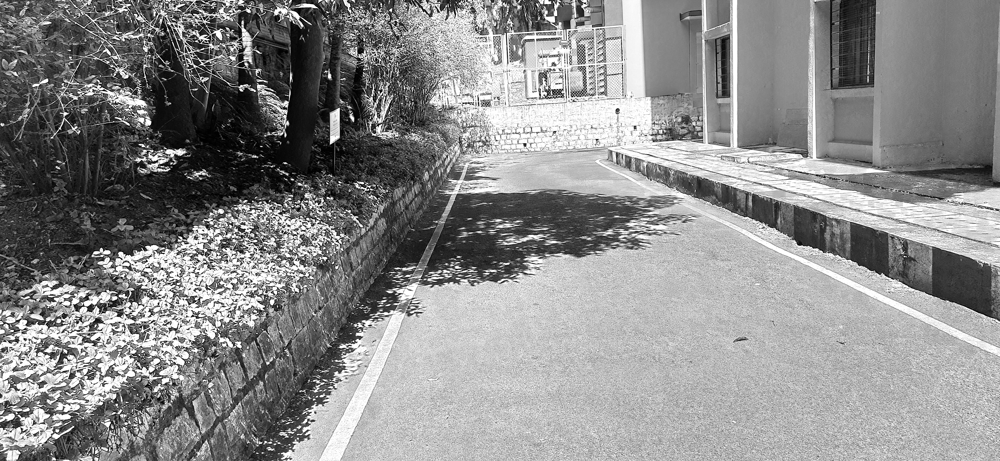

In [20]:
# TOP HAT TRANSFORM
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def remove_shadows(image_path, neighborhood_size=25):
    # Read the image
    image = cv2.imread(image_path)

    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply a morphological top-hat operation to highlight shadows
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (neighborhood_size, neighborhood_size))
    top_hat = cv2.morphologyEx(gray, cv2.MORPH_TOPHAT, kernel)

    # Add the top-hat result to the original image to reduce shadows
    enhanced_image = cv2.add(gray, top_hat)

    # Display the original and enhanced images
    # cv2_imshow(gray)
    # cv2_imshow(top_hat)
    cv2_imshow(enhanced_image)

    return enhanced_image

# Example usage
image_path = '/content/ShadowRemoval1.jpg'
enhanced_image = remove_shadows(image_path)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


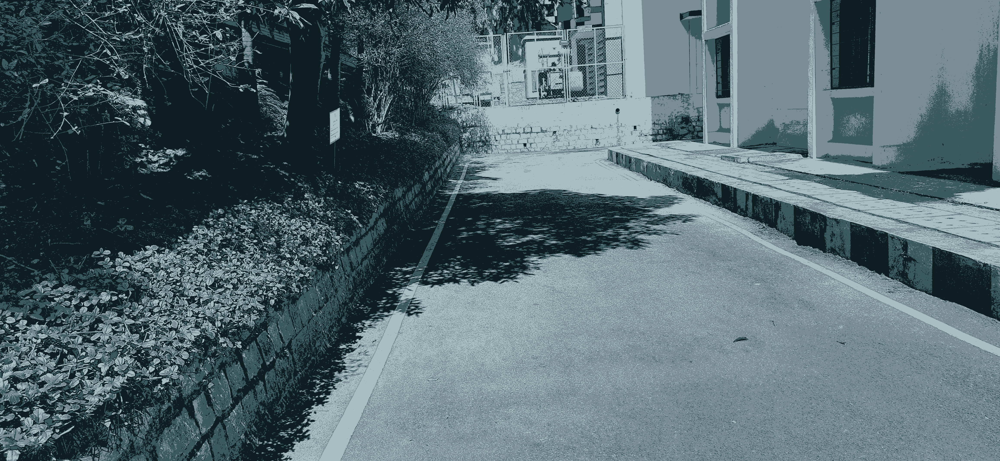

In [21]:
# K-MEANS
import cv2
import numpy as np
from sklearn.cluster import KMeans
from google.colab.patches import cv2_imshow

def remove_shadows_kmeans(image_path, num_clusters=4):
    # Read the image
    image = cv2.imread(image_path)

    # Reshape the image to a 2D array of pixels (rows * columns, channels)
    pixels = image.reshape((-1, 3))

    # Convert the data type to floating-point
    pixels = np.float32(pixels)

    # Apply k-means clustering
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(pixels)

    # Get the cluster centers and labels
    centers = np.uint8(kmeans.cluster_centers_)
    labels = kmeans.labels_

    # Assign each pixel the color of its cluster center
    segmented_image = centers[labels].reshape(image.shape)

    # # Display the original and segmented images
    # cv2_imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    cv2_imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))

    return segmented_image

# Example usage
image_path = '/content/ShadowRemoval1.jpg'
segmented_image = remove_shadows_kmeans(image_path)


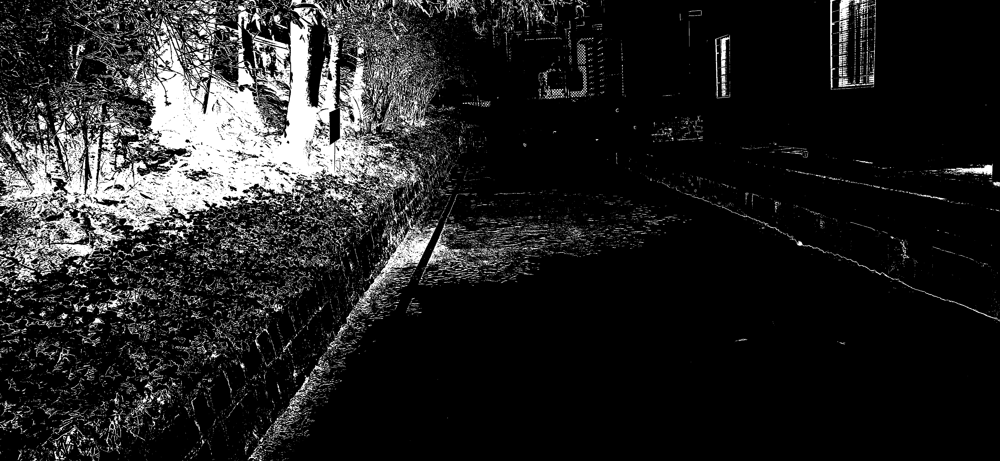

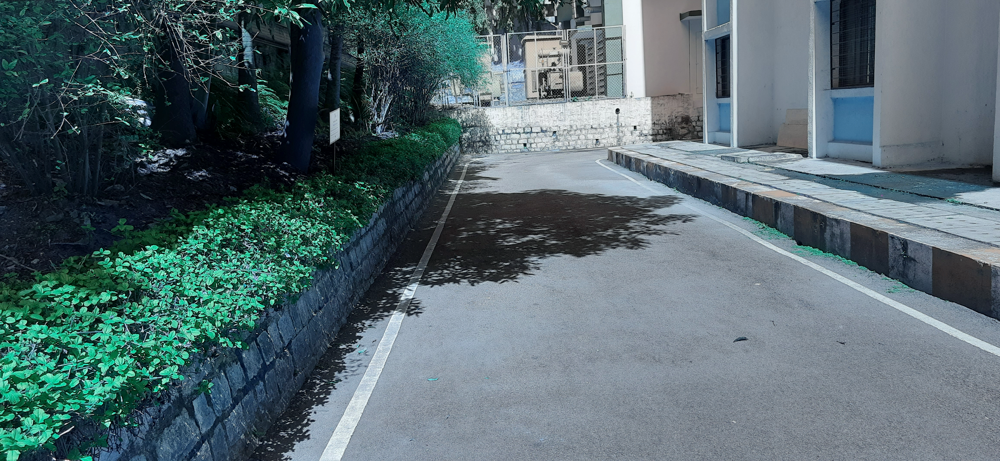

In [22]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def color_shadows_with_neighbors(image_path, luminance_threshold=25, neighborhood_size=19):
    # Read the image
    image = cv2.imread(image_path)

    # Convert the image to LAB color space
    lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)

    # Extract the L channel (luminance) from LAB
    luminance_channel = lab_image[:, :, 0]

    # Create a binary mask for shadows based on the luminance threshold
    shadow_mask = (luminance_channel < luminance_threshold).astype(np.uint8) * 255

    # Iterate through the image pixels
    for i in range(neighborhood_size, image.shape[0] - neighborhood_size):
        for j in range(neighborhood_size, image.shape[1] - neighborhood_size):
            # Check if the pixel is a shadow (based on the shadow mask)
            if shadow_mask[i, j] > 0:
                # Extract the neighborhood around the shadow pixel
                neighborhood = image[i - neighborhood_size:i + neighborhood_size + 1,
                                     j - neighborhood_size:j + neighborhood_size + 1]

                # Calculate the average color of the neighborhood
                average_color = np.mean(neighborhood, axis=(0, 1))

                # Replace the shadow pixel with the average color
                image[i, j] = average_color.astype(np.uint8)

    # Display the original image, shadow mask, and the image with colored shadows
    # cv2_imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    cv2_imshow(shadow_mask)
    cv2_imshow(cv2.cvtColor(lab_image, cv2.COLOR_LAB2RGB))

# Example usage
image_path = '/content/ShadowRemoval1.jpg'
color_shadows_with_neighbors(image_path)

